In [12]:
%matplotlib inline
import numpy as np
import sys, scipy, os, IPython.display
import matplotlib.pyplot as plt
import librosa
from scipy.io import wavfile

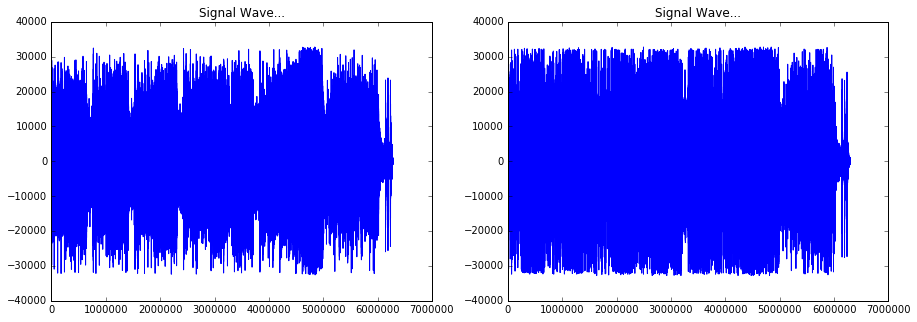

In [2]:
#import file
rate, signal = wavfile.read('../data/TheBeatles-ComeTogether.wav')

plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
plt.title('Signal Wave...')
plt.plot(signal[:,0])

plt.subplot(1, 2, 2)
plt.title('Signal Wave...')
plt.plot(signal[:,1])
plt.show()

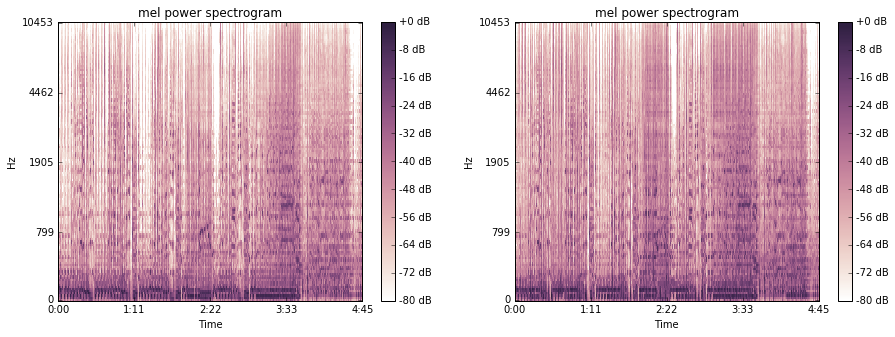

In [3]:
#Mel spectrogram
sr = rate
plt.figure(figsize=(15, 5))
for i in xrange(2):
    plt.subplot(1, 2, i+1)
    y = signal[:,i]

    S = librosa.feature.melspectrogram(y, sr=sr, n_mels=128)
    log_S = librosa.logamplitude(S, ref_power=np.max)

    librosa.display.specshow(log_S, sr=sr, x_axis='time', y_axis='mel')
    plt.title('mel power spectrogram')
    plt.colorbar(format='%+02.0f dB')

plt.show()

(13, 12288) (128, 12288)
(13, 12288) (128, 12288)


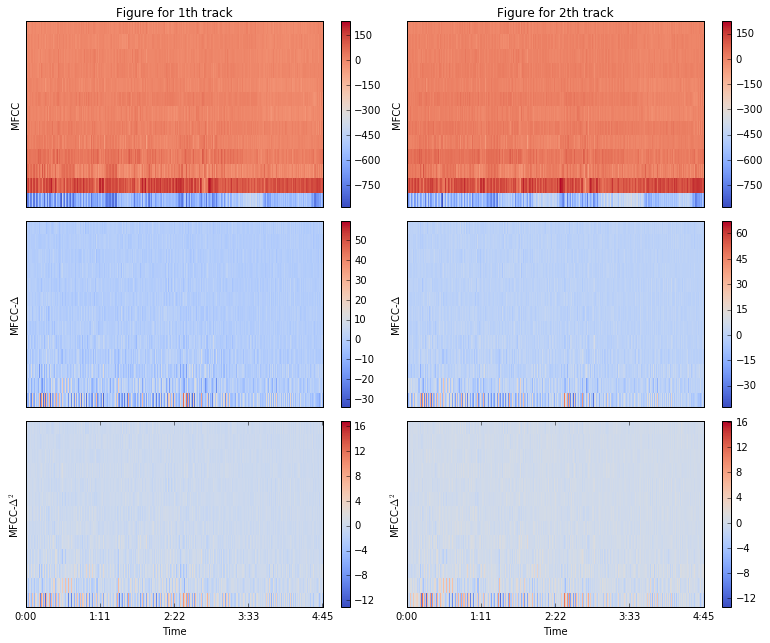

In [26]:
for i in xrange(2):
    y = signal[:,i]
    S = librosa.feature.melspectrogram(y, sr=sr, n_mels=128)
    log_S = librosa.logamplitude(S, ref_power=np.max)

    mfcc        = librosa.feature.mfcc(S=log_S, n_mfcc=13)
    print mfcc.shape, log_S.shape
    delta_mfcc  = librosa.feature.delta(mfcc)
    delta2_mfcc = librosa.feature.delta(mfcc, order=2)

    plt.subplot(3,2,1+i)
    librosa.display.specshow(mfcc)
    plt.title('Figure for {0}th track'.format(i+1))
    plt.ylabel('MFCC')
    plt.colorbar()

    plt.subplot(3,2,3+i)
    librosa.display.specshow(delta_mfcc)
    plt.ylabel('MFCC-$\Delta$')
    plt.colorbar()

    plt.subplot(3,2,5+i)
    librosa.display.specshow(delta2_mfcc, sr=sr, x_axis='time')
    plt.ylabel('MFCC-$\Delta^2$')
    plt.colorbar()

    plt.tight_layout()

# For future use, we'll stack these together into one matrix
M = np.vstack([mfcc, delta_mfcc, delta2_mfcc])

In [18]:
y = np.array(signal[:,0], dtype=np.float64)
y_harmonic, y_percussive = librosa.effects.hpss(y)

In [40]:
IPython.display.Audio(y_harmonic, rate=rate)

In [41]:
IPython.display.Audio(y_percussive, rate=rate)

In [42]:
from sklearn.cluster import MiniBatchKMeans
y = signal[:,0]
mfcc = np.transpose(librosa.feature.mfcc(y=y, n_mfcc=20, sr = rate))
print mfcc.shape
n, dim = mfcc.shape
clf = MiniBatchKMeans(n_clusters=100, batch_size=int(n*0.1), max_iter=200, max_no_improvement=None).fit(mfcc)

(12288, 20)


In [50]:
a = np.ones((1, clf.labels_.shape[0]))[0]
R = np.diag(a, 0)
print R.shape
print clf.labels_, clf.labels_.shape
for i in xrange(len(clf.labels_)-1):
    label = clf.labels_[i]
    for j in [j for j in xrange(i+1, len(clf.labels_)) if clf.labels_[i]==clf.labels_[j]]:
        R[i][j] = 1
        R[j][i] = 1
        
        


(12288, 12288)
[39 39 81 ..., 31 31 31] (12288,)
